### Notebook for the label transfer of WT mice to genotypes with `scANVI`

- **Developed by:** Carlos Talavera-López Ph.D
- **Würzburg Institute for Systems Immunology - Faculty of Medicine - Julius-Maximilian-Universität Würzburg**
- v230829

### Import required modules

In [1]:
import scvi
import torch
import anndata
import warnings
import numpy as np
import scanpy as sc
import pandas as pd
import plotnine as p
from pywaffle import Waffle
import matplotlib.pyplot as plt
from scib_metrics.benchmark import Benchmarker

/home/ceger/miniforge3/envs/heart_multiome-env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Set up working environment

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.5.post1
scanpy      1.9.8
-----
Cython              3.0.9
PIL                 10.2.0
absl                NA
annotated_types     0.6.0
anyio               NA
asttokens           NA
backoff             2.2.1
brotli              1.1.0
bs4                 4.12.3
certifi             2024.02.02
cffi                1.16.0
charset_normalizer  3.3.2
chex                0.1.85
click               8.1.7
colorama            0.4.6
comm                0.2.1
contextlib2         NA
croniter            NA
cycler              0.12.1
cython              3.0.9
cython_runtime      NA
dateutil            2.9.0
debugpy             1.8.1
decorator           5.1.1
deepdiff            6.7.1
docrep              0.3.2
etils               1.7.0
exceptiongroup      1.2.0
executing           2.0.1
fastapi             0.110.0
flax                0.8.1
fsspec              2024.2.0
gmpy2               2.1.2
google              NA
h5py                3.10.0
idna                3.6
igraph          

In [3]:
warnings.simplefilter(action = 'ignore')
scvi.settings.seed = 1712
%config InlineBackend.print_figure_kwargs = {'facecolor' : "w"}
%config InlineBackend.figure_format = 'retina'
torch.set_float32_matmul_precision('medium')

Global seed set to 1712


In [4]:
arches_params = dict(
    use_layer_norm = "both",
    use_batch_norm = "none",
    encode_covariates = True,
    dropout_rate = 0.2,
    n_layers = 3,
)

### Read in data

In [6]:
heart_scANVI = sc.read_h5ad('../../data/Kdm6aKO_ALL_GEX-CB_scANVI-CellStates_ctl240116.raw.h5ad')
heart_scANVI

AnnData object with n_obs × n_vars = 46135 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [7]:
heart_scANVI.obs_names = [name.rsplit('-', 1)[0] for name in heart_scANVI.obs_names]
heart_scANVI.obs_names

Index(['AAACAGCCACTAGCGT-1-KDM6A_wt_11', 'AAACAGCCAGCACGTT-1-KDM6A_wt_11',
       'AAACAGCCAGGCCATT-1-KDM6A_wt_11', 'AAACATGCAAACCTAT-1-KDM6A_wt_11',
       'AAACATGCAAATTGCT-1-KDM6A_wt_11', 'AAACATGCAAGTCGCT-1-KDM6A_wt_11',
       'AAACATGCACACCAAC-1-KDM6A_wt_11', 'AAACATGCATGTCGCG-1-KDM6A_wt_11',
       'AAACATGCATTATCCC-1-KDM6A_wt_11', 'AAACCAACAAACAACA-1-KDM6A_wt_11',
       ...
       'TTTGGTAAGGGATTAG-1-GSKJ4_treat_52',
       'TTTGTCCCAAAGGCCA-1-GSKJ4_treat_52',
       'TTTGTCCCATGAATAG-1-GSKJ4_treat_52',
       'TTTGTCTAGGGTGAAC-1-GSKJ4_treat_52',
       'TTTGTCTAGTACTGGT-1-GSKJ4_treat_52',
       'TTTGTCTAGTCATGCG-1-GSKJ4_treat_52',
       'TTTGTGAAGAAAGGAA-1-GSKJ4_treat_52',
       'TTTGTGGCAAGGTACG-1-GSKJ4_treat_52',
       'TTTGTTGGTCATTAGG-1-GSKJ4_treat_52',
       'TTTGTTGGTCCTAACT-1-GSKJ4_treat_52'],
      dtype='object', length=46135)

In [8]:
heart_scANVI.obs['seed_labels'] = heart_scANVI.obs['C_scANVI'].copy()
del(heart_scANVI.obs['C_scANVI'])
heart_scANVI

AnnData object with n_obs × n_vars = 46135 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

### Visualise cell type distribution per condition

In [9]:
heart_scANVI.obs['seed_labels'].value_counts()

vCM1             6808
EC1_cap          5340
FB1              5294
EC3_cap          2723
EC5_art          2518
                 ... 
ILC                 2
NC2                 2
NC6                 1
unclassfied.2       1
NC5                 1
Name: seed_labels, Length: 72, dtype: int64

In [10]:
pd.crosstab(heart_scANVI.obs['seed_labels'], heart_scANVI.obs['genotype'])

genotype,KO,WT,sham,treated
seed_labels,,,,
Adip1,21,21,1,6
Adip2,4,4,1,0
Adip3,0,4,0,0
Adip4,2,4,5,3
B,567,104,18,2
...,...,...,...,...
vCM1,1695,1916,1561,1636
vCM2,60,58,97,31
vCM3,147,206,470,420


### Read in other unannotated dataset and split into groups

In [11]:
heart_scANVI.obs['genotype'].value_counts()

KO         15704
WT         13991
sham       10539
treated     5901
Name: genotype, dtype: int64

In [12]:
reference = heart_scANVI[heart_scANVI.obs['genotype'].isin(['WT', 'Sham'])]
reference

View of AnnData object with n_obs × n_vars = 13991 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [13]:
query = heart_scANVI[~heart_scANVI.obs['genotype'].isin(['WT', 'Sham'])]
query.obs['seed_labels'] = 'Unknown'
query

AnnData object with n_obs × n_vars = 32144 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [14]:
adata = reference.concatenate(query, batch_key = 'batch', batch_categories = ['reference', 'query'], join = 'inner')
adata

AnnData object with n_obs × n_vars = 46135 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

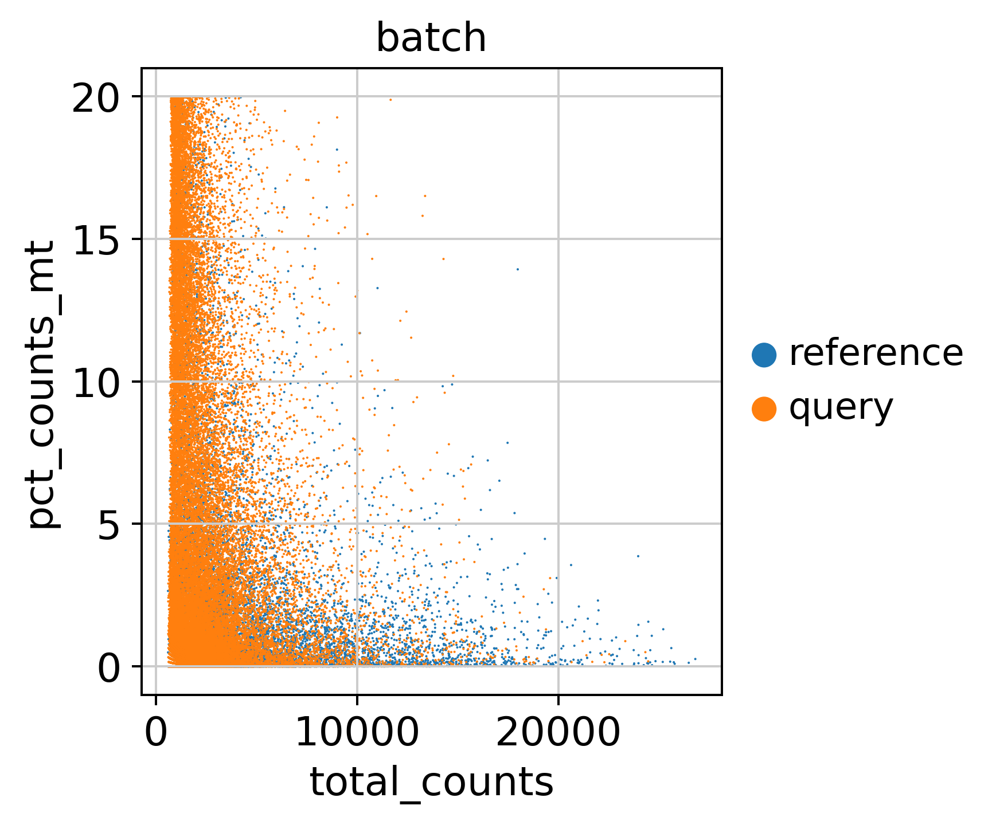

In [15]:
sc.pl.scatter(adata, x = 'total_counts', y = 'pct_counts_mt', color = "batch", frameon = False)

In [16]:
adata.obs['genotype'].value_counts()

KO         15704
WT         13991
sham       10539
treated     5901
Name: genotype, dtype: int64

In [17]:
adata.obs['sample'].value_counts()

KDM6A_KO_31       9865
KDM6A_wt_11       9488
GSKJ4_sham_51     7266
KDM6A_KO_34       5839
KDM6A_wt_40       4503
GSKJ4_sham_57     3273
GSKJ4_treat_47    3094
GSKJ4_treat_52    2807
Name: sample, dtype: int64

### Select HVGs

In [18]:
adata_raw = adata.copy()
adata.layers['counts'] = adata.X.copy()

sc.pp.highly_variable_genes(
    adata,
    flavor = "seurat_v3",
    n_top_genes = 7000,
    layer = "counts",
    batch_key = "sample",
    subset = True
)
adata

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 46135 × 7000
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'batch_colors', 'hvg'
    layers: 'counts'

### Transfer of annotation with scANVI

In [19]:
scvi.model.SCVI.setup_anndata(adata,
                              batch_key = "sample", 
                            categorical_covariate_keys = ["sample"], 
                            labels_key = "seed_labels", 
                            layer = 'counts')

In [20]:
scvi_model = scvi.model.SCVI(adata, 
                             n_latent = 50, 
                             n_layers = 3, 
                             dispersion = 'gene-batch', 
                             gene_likelihood = 'nb')

In [21]:
scvi_model.train(
    60,
    check_val_every_n_epoch = 1,
    enable_progress_bar = 1,
    devices=[1]
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Epoch 60/60: 100%|██████████| 60/60 [01:46<00:00,  1.77s/it, v_num=1, train_loss_step=1.33e+3, train_loss_epoch=1.28e+3]

`Trainer.fit` stopped: `max_epochs=60` reached.


Epoch 60/60: 100%|██████████| 60/60 [01:46<00:00,  1.77s/it, v_num=1, train_loss_step=1.33e+3, train_loss_epoch=1.28e+3]


In [22]:
adata.obsm["X_scVI"] = scvi_model.get_latent_representation(adata)

### Evaluate model performance using the [_Svensson_](https://www.nxn.se/valent/2023/8/10/training-scvi-posterior-predictive-distributions-over-epochs) method

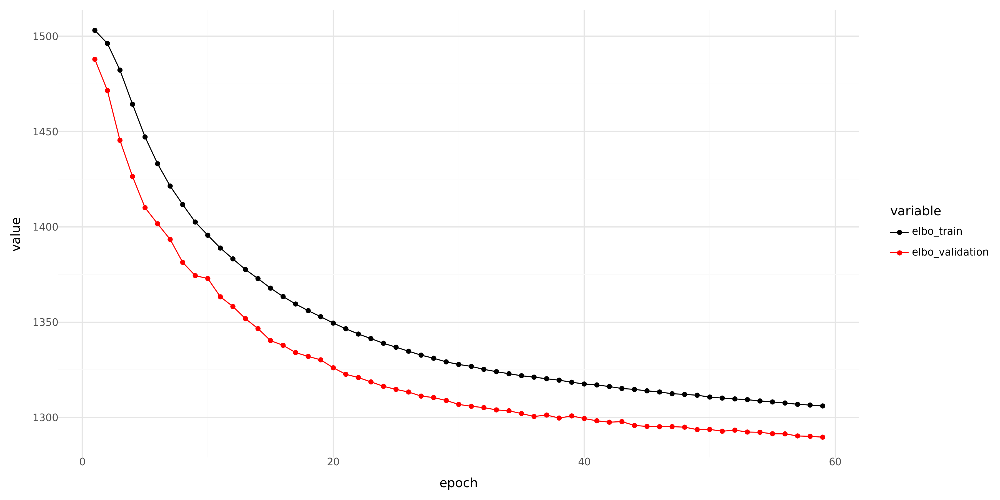

In [23]:
history_df = (
    scvi_model.history['elbo_train'].astype(float)
    .join(scvi_model.history['elbo_validation'].astype(float))
    .reset_index()
    .melt(id_vars = ['epoch'])
)

p.options.figure_size = 12, 6

p_ = (
    p.ggplot(p.aes(x = 'epoch', y = 'value', color = 'variable'), history_df.query('epoch > 0'))
    + p.geom_line()
    + p.geom_point()
    + p.scale_color_manual({'elbo_train': 'black', 'elbo_validation': 'red'})
    + p.theme_minimal()
)

p_.save('fig1.png', dpi = 300)

print(p_)

### Label transfer with `scANVI` 

In [24]:
scanvi_model = scvi.model.SCANVI.from_scvi_model(scvi_model, 'Unknown')

In [25]:
scanvi_model.train(50, 
                   check_val_every_n_epoch = 1, 
                   enable_progress_bar = True, 
                   devices = [1])

INFO     Training for 50 epochs.                                                                                   


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Epoch 50/50: 100%|██████████| 50/50 [04:21<00:00,  5.24s/it, v_num=1, train_loss_step=1.56e+3, train_loss_epoch=1.27e+3]

`Trainer.fit` stopped: `max_epochs=50` reached.


Epoch 50/50: 100%|██████████| 50/50 [04:21<00:00,  5.24s/it, v_num=1, train_loss_step=1.56e+3, train_loss_epoch=1.27e+3]


In [26]:
adata.obs["C_scANVI"] = scanvi_model.predict(adata)

- Extract latent representation

In [27]:
adata.obsm["X_scANVI"] = scanvi_model.get_latent_representation(adata)

### Explore model performance using the [_Svensson_](https://www.nxn.se/valent/2023/8/10/training-scvi-posterior-predictive-distributions-over-epochs) method

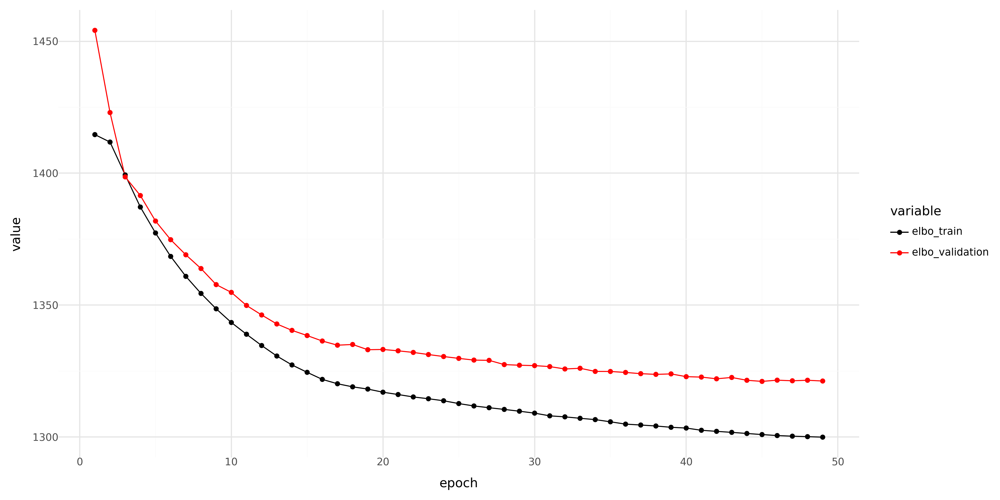

In [28]:
history_df = (
    scanvi_model.history['elbo_train'].astype(float)
    .join(scanvi_model.history['elbo_validation'].astype(float))
    .reset_index()
    .melt(id_vars = ['epoch'])
)

p.options.figure_size = 12, 6

p_ = (
    p.ggplot(p.aes(x = 'epoch', y = 'value', color = 'variable'), history_df.query('epoch > 0'))
    + p.geom_line()
    + p.geom_point()
    + p.scale_color_manual({'elbo_train': 'black', 'elbo_validation': 'red'})
    + p.theme_minimal()
)

p_.save('fig1.png', dpi = 300)

print(p_)

### Visualise corrected dataset

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:23)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:22)


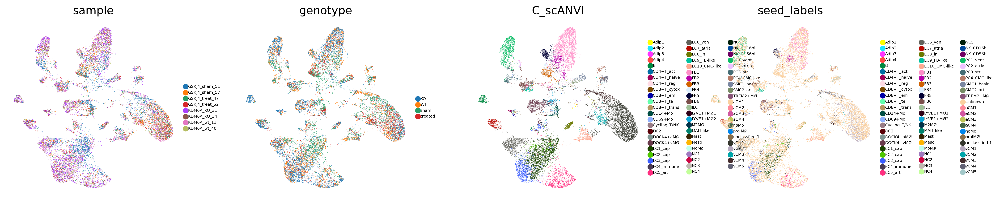

In [29]:
sc.pp.neighbors(adata, use_rep = "X_scANVI", n_neighbors = 50, metric = 'minkowski')
sc.tl.umap(adata, min_dist = 0.3, spread = 4, random_state = 1712)
sc.pl.umap(adata, frameon = False, color = ['sample', 'genotype', 'C_scANVI', 'seed_labels'], size = 0.6, legend_fontsize = 5, ncols = 4)

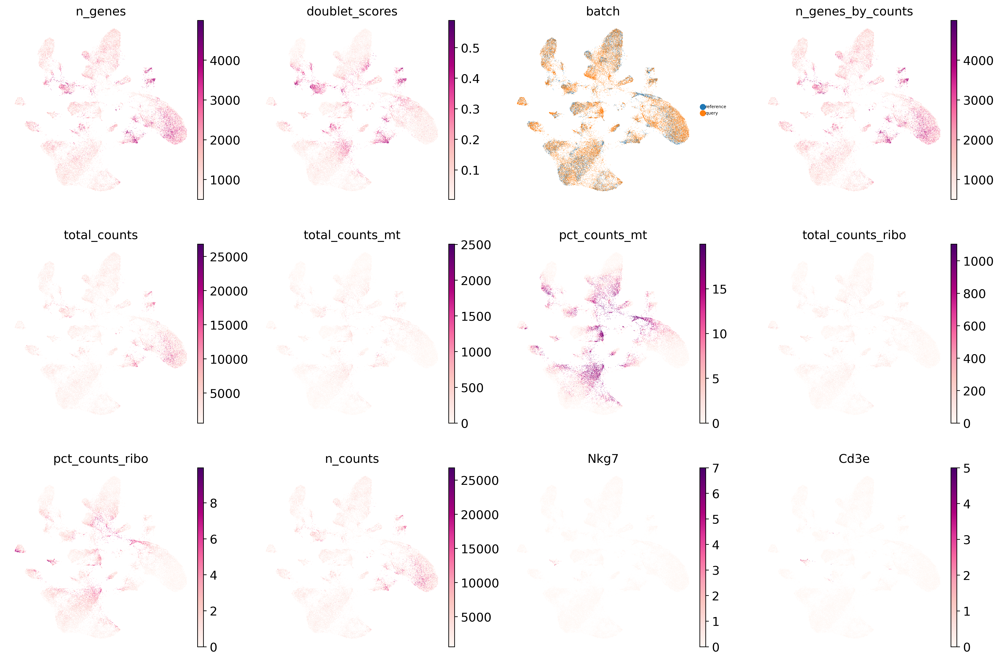

In [30]:
sc.pl.umap(adata, frameon = False, color = ['n_genes', 'doublet_scores', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts', 'Nkg7', 'Cd3e'], size = 0.6, legend_fontsize = 5, ncols = 4, cmap = 'RdPu')

### Evaluate integration with `scIB-metrics`

In [33]:
A

NameError: name 'A' is not defined

In [32]:
sc.pp.pca(adata, svd_solver = 'arpack', random_state = 1712)

computing PCA
    on highly variable genes
    with n_comps=50


ValueError: `A` must be of floating or complex floating data type.

In [34]:
bm = Benchmarker(
    adata,
    batch_key="sample",
    label_key="C_scANVI",
    embedding_obsm_keys=["X_pca", "X_scVI", "X_scANVI"],
    n_jobs = -1,
)
bm.benchmark()

computing PCA
    with n_comps=50


ValueError: `A` must be of floating or complex floating data type.

In [35]:
bm.plot_results_table()

ValueError: at least one array or dtype is required

In [36]:
bm.plot_results_table(min_max_scale = False)

KeyError: 'Batch correction'

### Modify object to plot canonical marker genes

In [37]:
adata_toplot = anndata.AnnData(X = np.sqrt(sc.pp.normalize_total(adata_raw, inplace = False)["X"]), var = adata_raw.var, obs = adata.obs, obsm = adata.obsm)
adata_toplot

normalizing counts per cell
    finished (0:00:00)


AnnData object with n_obs × n_vars = 46135 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: '_scvi_extra_categorical_covs', 'X_scVI', 'X_scANVI', 'X_umap'

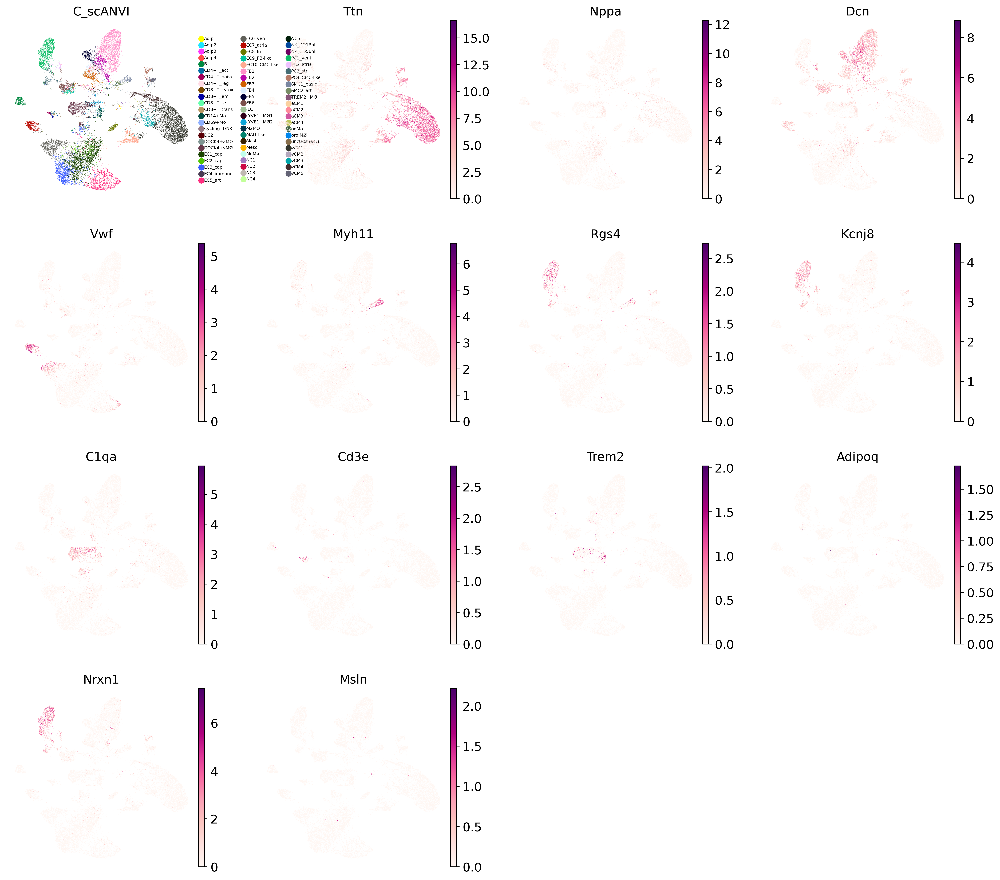

In [38]:
sc.pl.umap(adata_toplot, frameon = False, color = ['C_scANVI', 'Ttn', 'Nppa', 'Dcn', 'Vwf', 'Myh11', 'Rgs4', 'Kcnj8', 'C1qa', 'Cd3e', 'Trem2', 'Adipoq', 'Nrxn1', 'Msln'], size = 0.6, legend_fontsize = 5, ncols = 4, cmap = 'RdPu')

### Visualise proportions

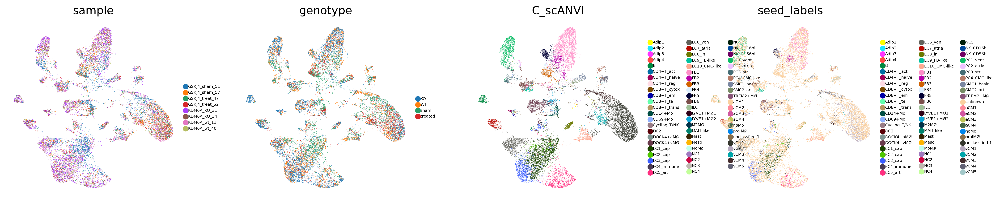

In [39]:
sc.pl.umap(adata, frameon = False, color = ['sample', 'genotype', 'C_scANVI', 'seed_labels'], size = 0.6, legend_fontsize = 5, ncols = 4)

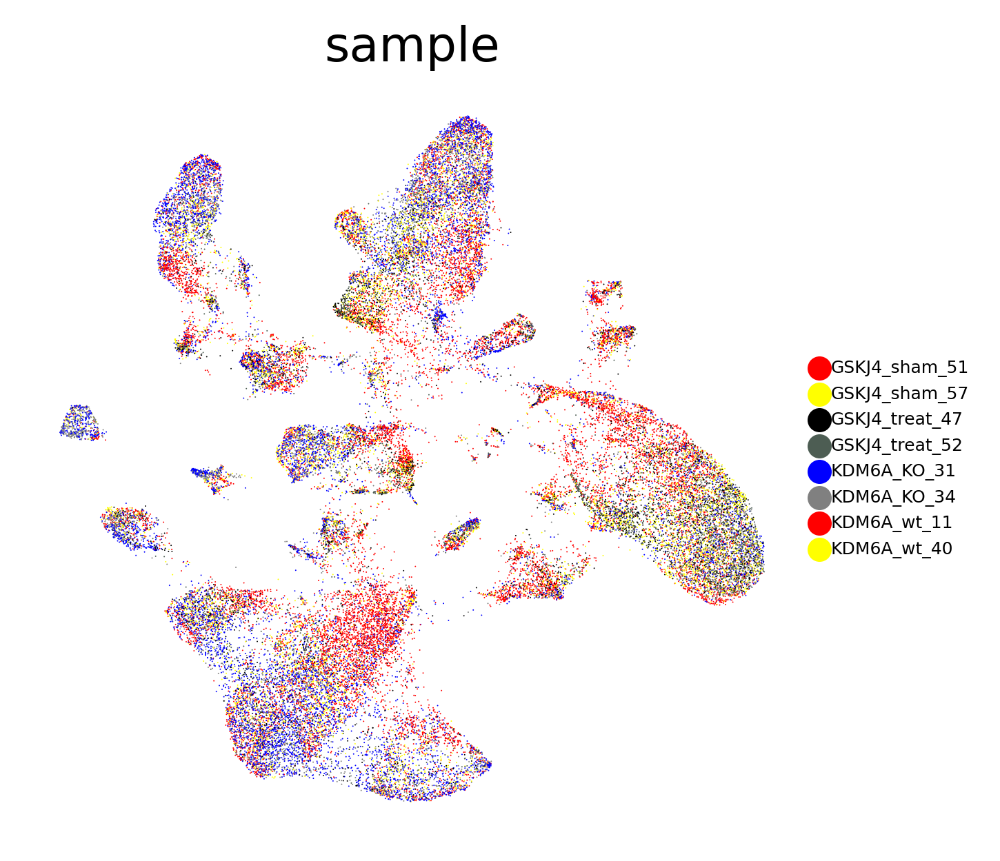

In [52]:
bauhaus_colors = ['#FF0000', '#FFFF00', '#000000', '#4D5D53', '#0000FF', '#808080']
sc.pl.umap(adata, frameon = False, color = ['sample'], size = 0.6, legend_fontsize = 5, ncols = 4, palette = bauhaus_colors)

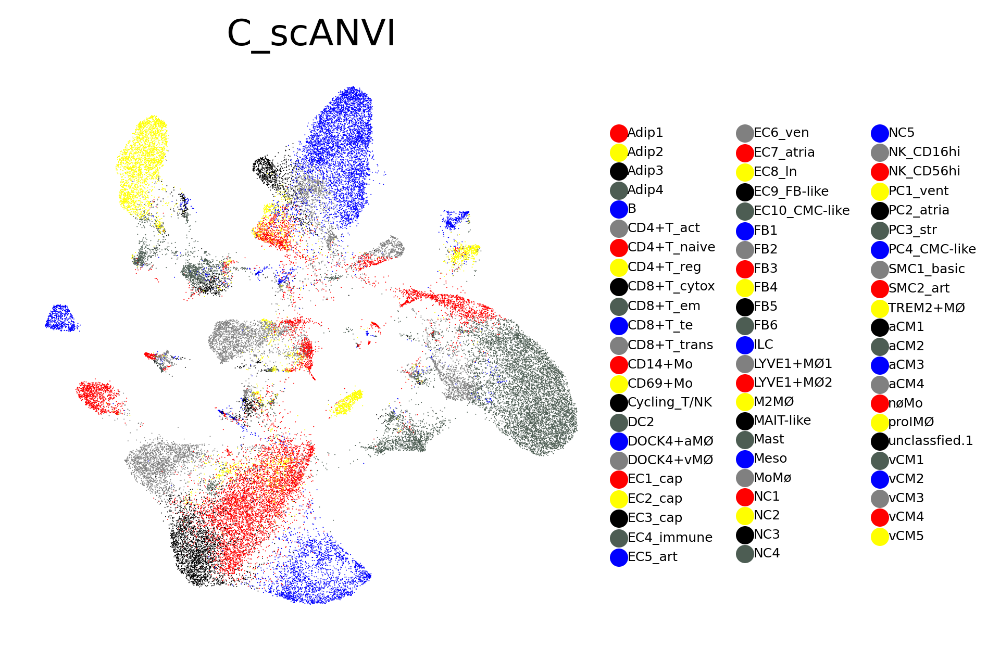

In [41]:
sc.pl.umap(adata, frameon = False, color = ['C_scANVI'], size = 0.6, legend_fontsize = 5, ncols = 4, palette = bauhaus_colors)

In [42]:
df = adata_toplot.obs.groupby(['genotype', 'C_scANVI']).size().reset_index(name = 'counts')

grouped = df.groupby('genotype')['counts'].apply(lambda x: x / x.sum() * 100)
grouped = grouped.reset_index()

df['proportions'] = grouped['counts']
df['waffle_counts'] = (df['proportions'] * 10).astype(int)

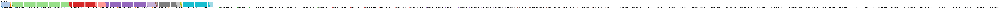

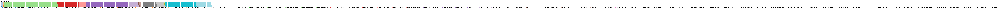

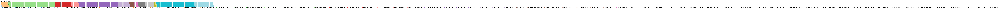

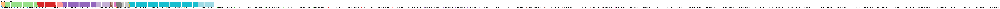

In [43]:
tab20_palette = plt.cm.get_cmap('tab20', len(df['C_scANVI'].unique()))


for group in df['genotype'].unique():
    temp_df = df[df['genotype'] == group]
    
    data = dict(zip(temp_df['C_scANVI'], temp_df['waffle_counts']))
    colors = [tab20_palette(i) for i in range(len(temp_df['C_scANVI']))]
    fig = plt.figure(
        FigureClass = Waffle, 
        rows = 5, 
        values = data, 
        title = {'label': f'Genotype {group}', 'loc': 'left', 'fontsize': 14},
        labels = [f"{k} ({v}%)" for k, v in zip(temp_df['C_scANVI'], temp_df['proportions'].round(2))],
        #legend = {'loc': 'lower left', 'bbox_to_anchor': (0, -0.4), 'ncol': len(data), 'framealpha': 0},
        legend = {'loc': 'lower left', 'bbox_to_anchor': (0, -0.4), 'ncol': len(data), 'framealpha': 0, 'fontsize': 14},
        figsize = (40, 4),
        colors = colors
    )
    plt.show()

### Export annotated sample object 

In [44]:
adata.obs.index = pd.Index(['-'.join(idx.split('-')[:3]) for idx in adata.obs.index])
adata.obs.index

Index(['AAACAGCCACTAGCGT-1-KDM6A_wt_11', 'AAACAGCCAGCACGTT-1-KDM6A_wt_11',
       'AAACAGCCAGGCCATT-1-KDM6A_wt_11', 'AAACATGCAAACCTAT-1-KDM6A_wt_11',
       'AAACATGCAAATTGCT-1-KDM6A_wt_11', 'AAACATGCAAGTCGCT-1-KDM6A_wt_11',
       'AAACATGCACACCAAC-1-KDM6A_wt_11', 'AAACATGCATGTCGCG-1-KDM6A_wt_11',
       'AAACATGCATTATCCC-1-KDM6A_wt_11', 'AAACCAACAAACAACA-1-KDM6A_wt_11',
       ...
       'TTTGGTAAGGGATTAG-1-GSKJ4_treat_52',
       'TTTGTCCCAAAGGCCA-1-GSKJ4_treat_52',
       'TTTGTCCCATGAATAG-1-GSKJ4_treat_52',
       'TTTGTCTAGGGTGAAC-1-GSKJ4_treat_52',
       'TTTGTCTAGTACTGGT-1-GSKJ4_treat_52',
       'TTTGTCTAGTCATGCG-1-GSKJ4_treat_52',
       'TTTGTGAAGAAAGGAA-1-GSKJ4_treat_52',
       'TTTGTGGCAAGGTACG-1-GSKJ4_treat_52',
       'TTTGTTGGTCATTAGG-1-GSKJ4_treat_52',
       'TTTGTTGGTCCTAACT-1-GSKJ4_treat_52'],
      dtype='object', length=46135)

In [45]:
adata_raw.obs.index = pd.Index(['-'.join(idx.split('-')[:3]) for idx in adata_raw.obs.index])
adata_raw.obs.index

Index(['AAACAGCCACTAGCGT-1-KDM6A_wt_11', 'AAACAGCCAGCACGTT-1-KDM6A_wt_11',
       'AAACAGCCAGGCCATT-1-KDM6A_wt_11', 'AAACATGCAAACCTAT-1-KDM6A_wt_11',
       'AAACATGCAAATTGCT-1-KDM6A_wt_11', 'AAACATGCAAGTCGCT-1-KDM6A_wt_11',
       'AAACATGCACACCAAC-1-KDM6A_wt_11', 'AAACATGCATGTCGCG-1-KDM6A_wt_11',
       'AAACATGCATTATCCC-1-KDM6A_wt_11', 'AAACCAACAAACAACA-1-KDM6A_wt_11',
       ...
       'TTTGGTAAGGGATTAG-1-GSKJ4_treat_52',
       'TTTGTCCCAAAGGCCA-1-GSKJ4_treat_52',
       'TTTGTCCCATGAATAG-1-GSKJ4_treat_52',
       'TTTGTCTAGGGTGAAC-1-GSKJ4_treat_52',
       'TTTGTCTAGTACTGGT-1-GSKJ4_treat_52',
       'TTTGTCTAGTCATGCG-1-GSKJ4_treat_52',
       'TTTGTGAAGAAAGGAA-1-GSKJ4_treat_52',
       'TTTGTGGCAAGGTACG-1-GSKJ4_treat_52',
       'TTTGTTGGTCATTAGG-1-GSKJ4_treat_52',
       'TTTGTTGGTCCTAACT-1-GSKJ4_treat_52'],
      dtype='object', length=46135)

In [46]:
adata.obs_names

Index(['AAACAGCCACTAGCGT-1-KDM6A_wt_11', 'AAACAGCCAGCACGTT-1-KDM6A_wt_11',
       'AAACAGCCAGGCCATT-1-KDM6A_wt_11', 'AAACATGCAAACCTAT-1-KDM6A_wt_11',
       'AAACATGCAAATTGCT-1-KDM6A_wt_11', 'AAACATGCAAGTCGCT-1-KDM6A_wt_11',
       'AAACATGCACACCAAC-1-KDM6A_wt_11', 'AAACATGCATGTCGCG-1-KDM6A_wt_11',
       'AAACATGCATTATCCC-1-KDM6A_wt_11', 'AAACCAACAAACAACA-1-KDM6A_wt_11',
       ...
       'TTTGGTAAGGGATTAG-1-GSKJ4_treat_52',
       'TTTGTCCCAAAGGCCA-1-GSKJ4_treat_52',
       'TTTGTCCCATGAATAG-1-GSKJ4_treat_52',
       'TTTGTCTAGGGTGAAC-1-GSKJ4_treat_52',
       'TTTGTCTAGTACTGGT-1-GSKJ4_treat_52',
       'TTTGTCTAGTCATGCG-1-GSKJ4_treat_52',
       'TTTGTGAAGAAAGGAA-1-GSKJ4_treat_52',
       'TTTGTGGCAAGGTACG-1-GSKJ4_treat_52',
       'TTTGTTGGTCATTAGG-1-GSKJ4_treat_52',
       'TTTGTTGGTCCTAACT-1-GSKJ4_treat_52'],
      dtype='object', length=46135)

In [47]:
adata.obs['C_scANVI'].cat.categories

Index(['Adip1', 'Adip2', 'Adip3', 'Adip4', 'B', 'CD4+T_act', 'CD4+T_naive',
       'CD4+T_reg', 'CD8+T_cytox', 'CD8+T_em', 'CD8+T_te', 'CD8+T_trans',
       'CD14+Mo', 'CD69+Mo', 'Cycling_T/NK', 'DC2', 'DOCK4+aMØ', 'DOCK4+vMØ',
       'EC1_cap', 'EC2_cap', 'EC3_cap', 'EC4_immune', 'EC5_art', 'EC6_ven',
       'EC7_atria', 'EC8_ln', 'EC9_FB-like', 'EC10_CMC-like', 'FB1', 'FB2',
       'FB3', 'FB4', 'FB5', 'FB6', 'ILC', 'LYVE1+MØ1', 'LYVE1+MØ2', 'M2MØ',
       'MAIT-like', 'Mast', 'Meso', 'MoMø', 'NC1', 'NC2', 'NC3', 'NC4', 'NC5',
       'NK_CD16hi', 'NK_CD56hi', 'PC1_vent', 'PC2_atria', 'PC3_str',
       'PC4_CMC-like', 'SMC1_basic', 'SMC2_art', 'TREM2+MØ', 'aCM1', 'aCM2',
       'aCM3', 'aCM4', 'nøMo', 'proIMØ', 'unclassfied.1', 'vCM1', 'vCM2',
       'vCM3', 'vCM4', 'vCM5'],
      dtype='object')

In [48]:
adata.obs['C_scANVI'].value_counts()

vCM1        7484
FB1         5497
EC1_cap     5398
EC3_cap     2844
PC1_vent    2692
            ... 
NC4            3
Adip2          3
ILC            2
NC2            2
NC5            1
Name: C_scANVI, Length: 68, dtype: int64

### Export annotated object with raw counts

In [49]:
adata

AnnData object with n_obs × n_vars = 46135 × 7000
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'batch_colors', 'hvg', '_scvi_uuid', '_scvi_manager_uuid', 'neighbors', 'umap', 'sample_colors', 'genotype_colors', 'C_scANVI_colors', 'seed_labels_colors'
    obsm: '_scvi_extra_categorical_covs', 'X_scVI', 'X_scANVI', 'X_umap'
 

In [50]:
adata_raw

AnnData object with n_obs × n_vars = 46135 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'batch_colors'

In [51]:
adata_export = anndata.AnnData(X = adata_raw.X, obs = adata.obs, var = adata_raw.var)
adata_export.obsm['X_scVI'] = adata.obsm['X_scVI'].copy()
adata_export.obsm['X_umap'] = adata.obsm['X_umap'].copy()
adata_export.obsm['X_scANVI'] = adata.obsm['X_scANVI'].copy()
adata_export

AnnData object with n_obs × n_vars = 46135 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scVI', 'X_umap', 'X_scANVI'

In [53]:
adata_export.write_h5ad('../../data/Kdm6aKO_ALL_GEX-CB_scANVI-CellTypes_ctl240117.raw.h5ad')